In [1]:
import os
import sys
module_path = os.path.abspath(os.path.join('../src/'))
if module_path not in sys.path:
    sys.path.append(module_path)

os.chdir("../")
print("Current working directory:", os.getcwd())

Current working directory: /home/ec2-user/workspace/loce


## Distibution

/home/ec2-user/workspace/venvs/gcpv_venv_no_gpu/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


2025-01-29 16:41:46.310 INFO loce_clusterer.py.loce_dendogram:761 Plotting dendogram...



EfficientNet.features.7.0.all.euclidean


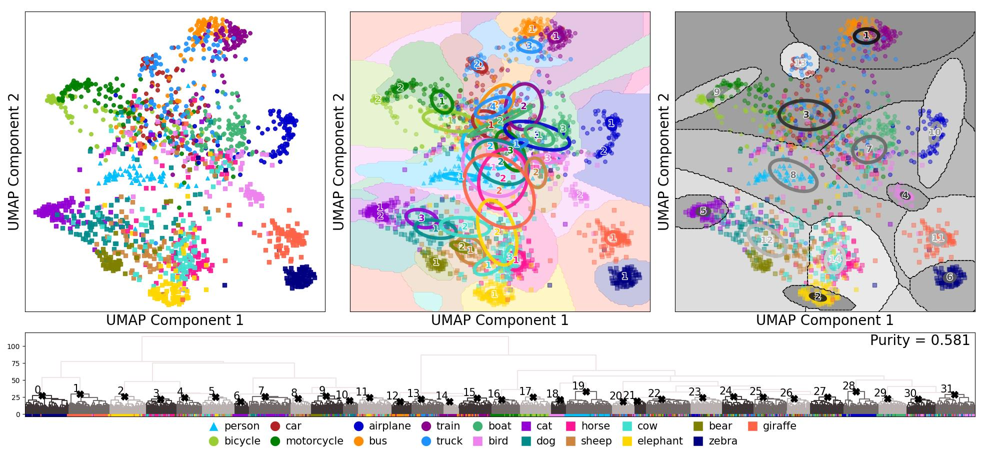

In [2]:
%matplotlib inline

from PIL import Image

from loce import LoCEDimensionReducer, LoCEMultilayerStorageDirectoryLoader, LoCEExperimentConstants

in_dir = "./experiment_outputs/optimized_loces_coco/"
out_dir = "./experiment_outputs/umap_coco/"
seed = 42
model_tag = "efficientnet"
segmentation_type = "original"
dataset = "coco"

method = "ward"
distance = "euclidean"

layer = "features.7.0"

category_set_name = "all"

category_sets = {
        category_set_name: LoCEExperimentConstants.MSCOCO_CATEGORIES_ALL,
    }

loce_dir = os.path.join(in_dir, f"loce_{segmentation_type}_{model_tag}")
loce_loader_one_model = LoCEMultilayerStorageDirectoryLoader(loce_dir, seed=seed)

loce_reducer = LoCEDimensionReducer(out_dir_base=out_dir, method_distance=[(method, distance)], seed=seed, n_samples_per_tag=100)
# override category sets for clarity, the same as in the original experiment
loce_reducer.category_sets = category_sets
loce_reducer.evaluate_one_single_plot(loce_loader_one_model, model_tag, [layer], dataset_tag=dataset)


# Display the image (PDF file is also saved in the same folder)
folder_name = f"{layer}_{method}_{distance}"
file_name = f"umap_{model_tag}_{layer}_{category_set_name}_{distance}_one_plot.jpg"

image = Image.open(os.path.join(out_dir, model_tag, category_set_name, folder_name, file_name))
image.show()

## Distribution: GMM components content

train GMM component 1


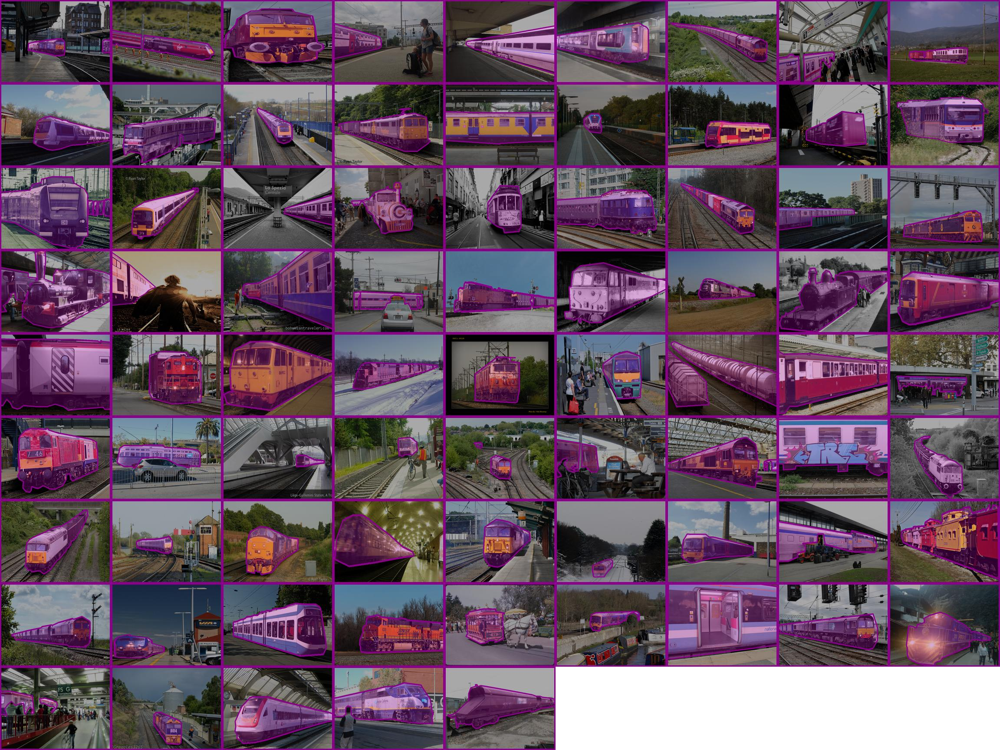

train GMM component 2


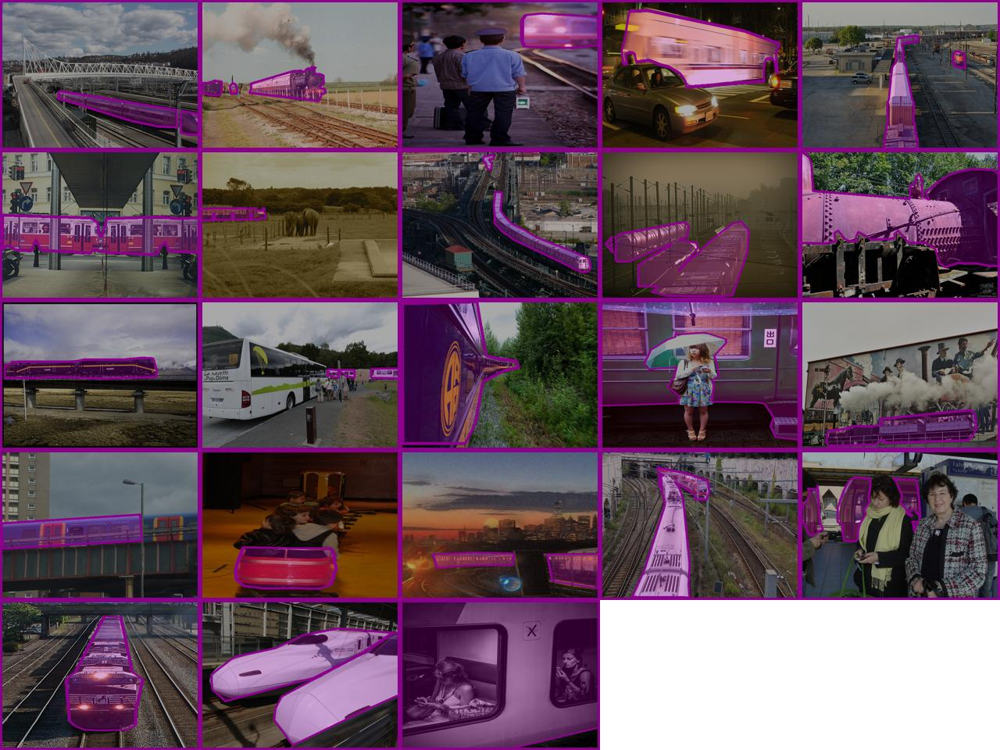

In [3]:
from loce import MSCOCO_CATEGORIES

# show content of GMM components (top middle)
cat_id = 7  # train

gmm_ids = [1, 2]

for gmm_id in gmm_ids:
    print(MSCOCO_CATEGORIES[cat_id], "GMM component", gmm_id)
    image = Image.open(os.path.join(out_dir, model_tag, category_set_name, folder_name, "loce_umap_gmm_imgs_tiles", f"category_{cat_id}_gmm_{gmm_id}.jpg"))
    image.show()

## Purity and Number of Clusters

In [4]:
from xai_utils.files import read_pickle
import numpy as np

from loce import shorten_layer_name


n_eval = 10  # average results across 10 different initializations

purity_layers = ["features.5.2", "features.6.2", "features.7.0"]  # layers to evaluate

col_width = 13
idx_width = 20

# evaluate purities and save the results
# same settings, but more layers, only one model for simplicity
loce_reducer.evaluate_many_purities([model_tag], {model_tag: purity_layers}, n_eval=n_eval, dataset_tag=dataset)
res = read_pickle(os.path.join(out_dir, "cluster_state.pkl"))

cat_dict = res[(method, distance)][category_set_name]

# table printing
print("\n")
hdr1 = "".rjust(idx_width) + ' & ' + ' & '.join(["Purity".center(col_width) for l in purity_layers]) + ' & ' + ' & '.join(["Clusters".center(col_width) for l in purity_layers])
print(hdr1)
hdr2 = "".rjust(idx_width) + ' & ' + ' & '.join([shorten_layer_name(l).center(col_width) for l in purity_layers] * 2)
print(hdr2)

for net_tag in [model_tag]:

    purities = []
    clusters = []

    for l in purity_layers:

        values = np.array(cat_dict[net_tag][l])

        purities_val = values[:, 0]
        n_clusters_val = values[:, 1]

        purity_mean = purities_val.mean()
        purity_std = purities_val.std()

        n_clusters_mean = n_clusters_val.mean()
        n_clusters_std = n_clusters_val.std()

        purity_str = f"{purity_mean:.2f}" + u"\u00B1" + f"{purity_std:.2f}"
        n_clusters_str = f"{n_clusters_mean:.1f}" + u"\u00B1" + f"{n_clusters_std:.1f}"

        purities.append(purity_str.center(col_width))
        clusters.append(n_clusters_str.center(col_width))

    print(model_tag.rjust(idx_width) + " & " + " & ".join(purities) + " & " + " & ".join(clusters))


100%|██████████| 10/10 [00:48<00:00,  4.90s/it]



                     &     Purity    &     Purity    &     Purity    &    Clusters   &    Clusters   &    Clusters  
                     &     f.5.2     &     f.6.2     &     f.7.0     &     f.5.2     &     f.6.2     &     f.7.0    
        efficientnet &   0.30±0.00   &   0.42±0.00   &   0.58±0.00   &    31.0±0.0   &    29.0±0.0   &    32.0±0.0  


## Separation (Absolute)

In [5]:
from loce import LoCEMultilayerStorageSeparation

separation_layers = purity_layers
categories = LoCEExperimentConstants.MSCOCO_CATEGORIES_ALL

separator = LoCEMultilayerStorageSeparation(loce_dir)


results_in_layers = {}

for l in separation_layers:
    results_in_layers[l] = separator.category_separation(categories, l)

    
header_row = "Category".rjust(idx_width) + " & " + " & ".join([shorten_layer_name(l).center(col_width) for l in separation_layers])
print(header_row)


for c in categories:
    row = f"{MSCOCO_CATEGORIES[c]}".rjust(idx_width)
    for l in separation_layers:
        value = results_in_layers[l][c]["separation_index"]
        row += " & " + f"{value:.2f}".center(col_width)
    print(row)



            Category &     f.5.2     &     f.6.2     &     f.7.0    
              person &      0.57     &      0.46     &      0.24    
             bicycle &      0.38     &      0.40     &      0.31    
                 car &      0.16     &      0.25     &      0.18    
          motorcycle &      0.58     &      0.39     &      0.24    
            airplane &      0.56     &      0.62     &      0.63    
                 bus &      0.15     &      0.14     &      0.15    
               train &      0.15     &      0.14     &      0.24    
               truck &      0.15     &      0.17     &      0.14    
                boat &      0.50     &      0.40     &      0.19    
                bird &      0.54     &      0.55     &      0.47    
                 cat &      0.15     &      0.11     &      0.07    
                 dog &      0.15     &      0.11     &      0.07    
               horse &      0.50     &      0.40     &      0.38    
               sheep &      0.47  

## Separation (Pairwise)

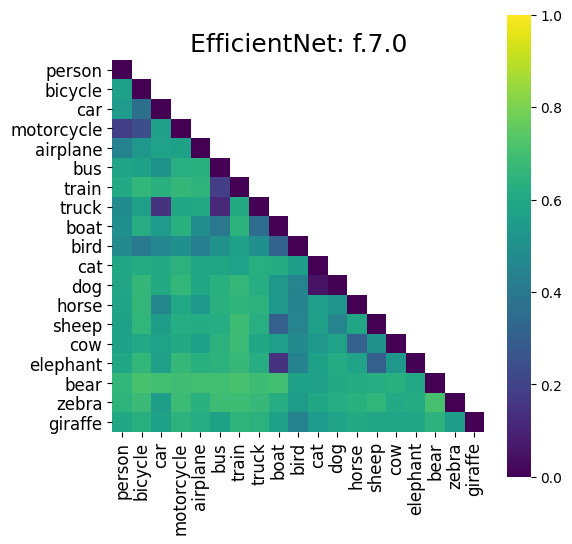

In [6]:

import seaborn as sns
import matplotlib.pyplot as plt

cmap_str = "viridis"

# separator as before
matrix = separator.pairwise_category_separation(categories, layer)

mask = np.triu(np.ones((len(categories), len(categories)), dtype=bool), k=1)

fig, ax = plt.subplots(figsize=(6, 6))
       
sns.heatmap(matrix, vmin=0, vmax=1, cmap=cmap_str, square=True, xticklabels=False, yticklabels=False, mask=mask, ax=ax)


tick_positions = np.arange(len(categories)) + 0.5  # Centered tick positions
x_ticks = [MSCOCO_CATEGORIES[c] for c in categories]
ax.set_xticks(tick_positions)
ax.set_xticklabels(x_ticks, rotation=90, fontsize=12)
y_ticks = [MSCOCO_CATEGORIES[c] for c in categories]
ax.set_yticks(tick_positions)
ax.set_yticklabels(y_ticks, rotation=0, fontsize=12)


ax.set_title(f"{LoCEExperimentConstants.NET_FULL_NAMES[net_tag]}: {shorten_layer_name(layer)}", fontsize=18)

plt.show()
plt.close()

## Overlap

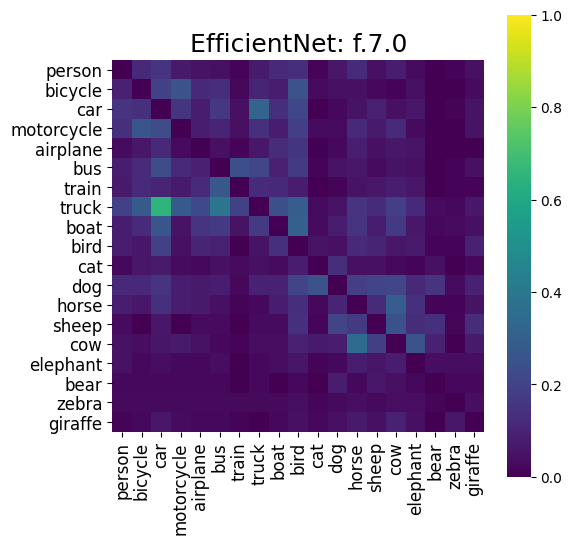

In [7]:
# separator as before
matrix = separator.overlap_ratio(categories, layer)

fig, ax = plt.subplots(figsize=(6, 6))
       
sns.heatmap(matrix, vmin=0, vmax=1, cmap=cmap_str, square=True, xticklabels=False, yticklabels=False, ax=ax)

# x_ticks, y_ticks, tick_positions as before
ax.set_xticks(tick_positions)
ax.set_xticklabels(x_ticks, rotation=90, fontsize=12)
ax.set_yticks(tick_positions)
ax.set_yticklabels(y_ticks, rotation=0, fontsize=12)


ax.set_title(f"{LoCEExperimentConstants.NET_FULL_NAMES[net_tag]}: {shorten_layer_name(layer)}", fontsize=18)

plt.show()
plt.close()

## Confusion (car/bus/truck)

2025-01-29 16:45:22.351 INFO loce_clusterer.py.loce_dendogram:761 Plotting dendogram...



EfficientNet.features.7.0.car_bus_truck.euclidean


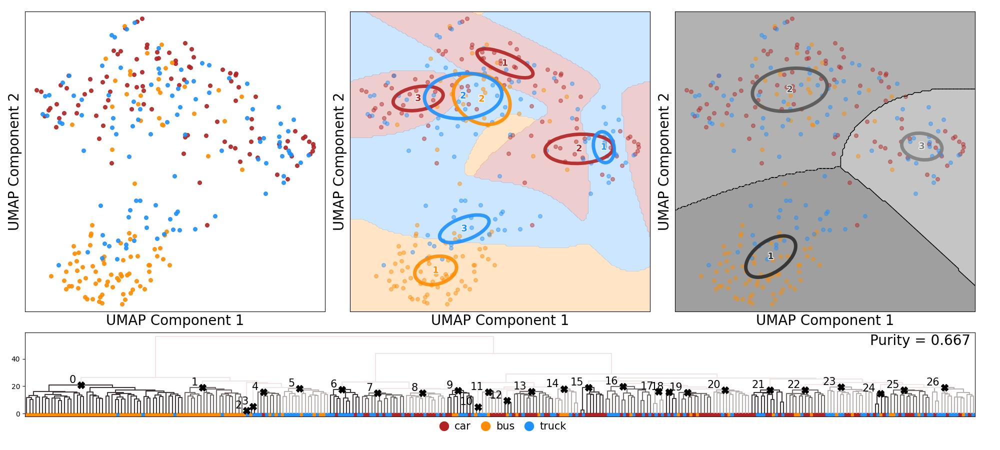

In [8]:
new_category_set_name = "car_bus_truck"

new_category_sets = {
    new_category_set_name: LoCEExperimentConstants.MSCOCO_CATEGORIES_CAR_BUS_TRUCK,
}

loce_reducer.category_sets = new_category_sets

loce_reducer.evaluate_one_single_plot(loce_loader_one_model, model_tag, [layer], dataset_tag=dataset)

if dataset == "voc":
    category_set_name = list(loce_reducer.category_sets_voc.keys())[0]
else:
    category_set_name = list(loce_reducer.category_sets.keys())[0]

folder_name = f"{layer}_{method}_{distance}"
file_name = f"umap_{model_tag}_{layer}_{category_set_name}_{distance}_one_plot.jpg"

image = Image.open(os.path.join(out_dir, model_tag, category_set_name, folder_name, file_name))
image.show()

## Confusion (car/bus/truck): GMM components content

GMM component 1


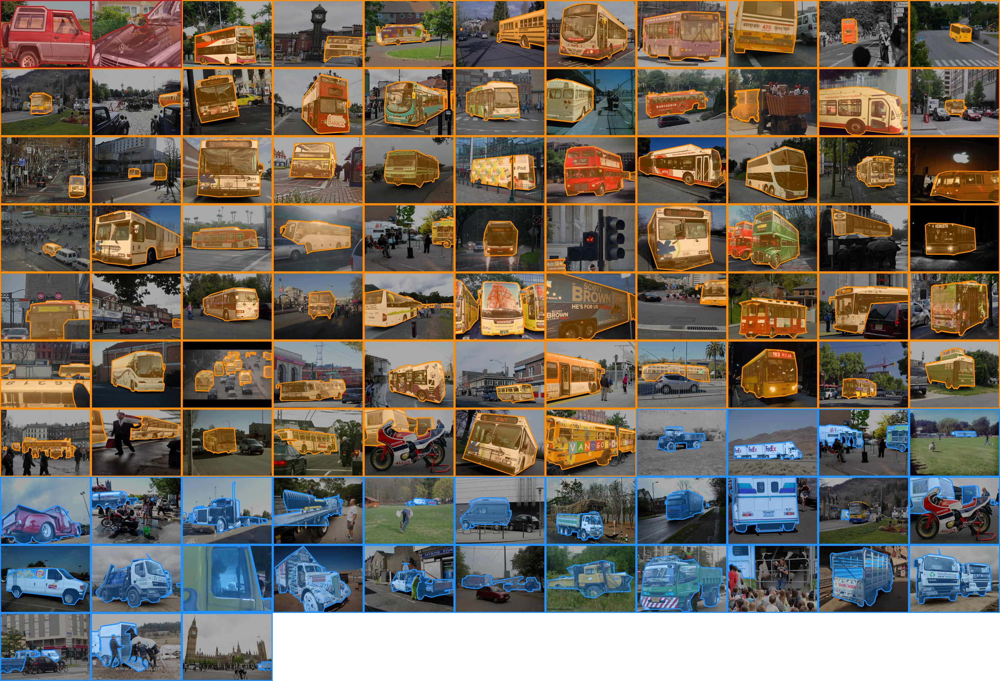

GMM component 2


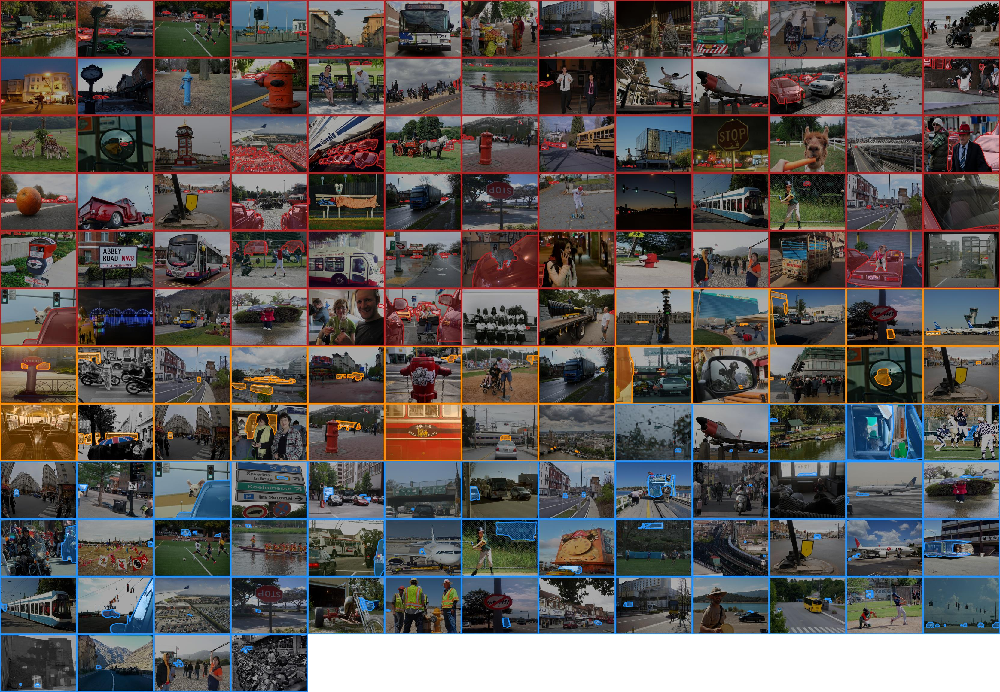

GMM component 3


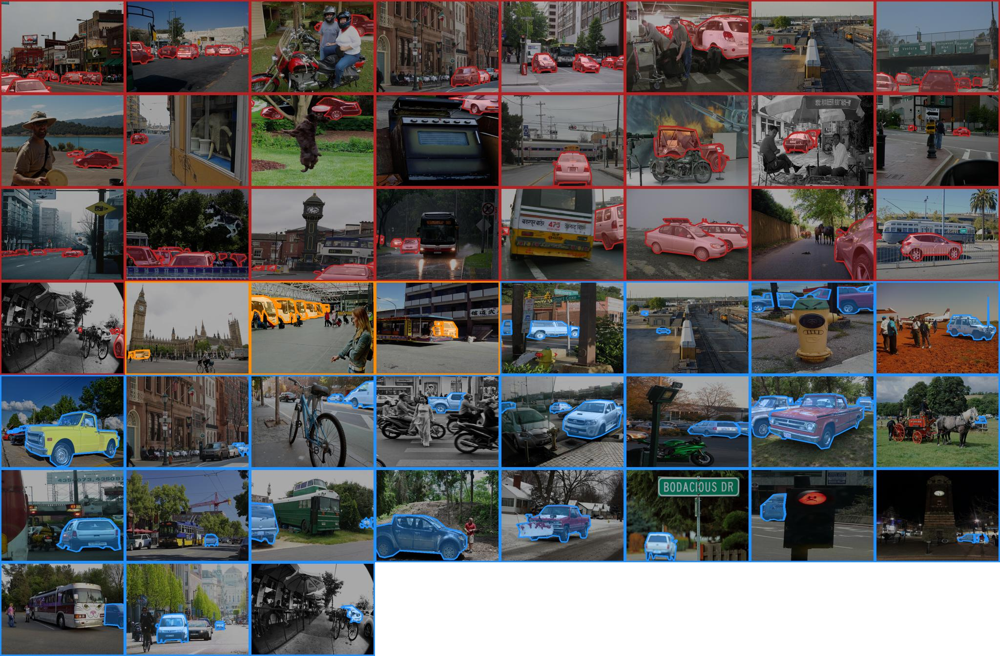

In [9]:
# show content of GMM components (top right)
gmm_ids = [1, 2, 3]

for gmm_id in gmm_ids:
    print("GMM component", gmm_id)
    image = Image.open(os.path.join(out_dir, model_tag, new_category_set_name, folder_name, "loce_umap_gmm_imgs_tiles_ignored_labels", f"category_-1_gmm_{gmm_id}.jpg"))
    image.show()